<a href="https://colab.research.google.com/github/oudeng/Epidemic_Models/blob/master/SIRV_deng.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

     |████████████████████████████████| 113 kB 4.4 MB/s 
  Created wheel for EoN: filename=EoN-1.1-py3-none-any.whl size=120819 sha256=cf6e22c047d5e5db7de873a1fe322908a8528b9fdb85ef5b1f9f384ebb645c1f
  Stored in directory: /root/.cache/pip/wheels/0b/c0/a4/d6001fd809cb84c027ada5c2ab3b6d1cb2e97fec3f9978eae7
Successfully built EoN


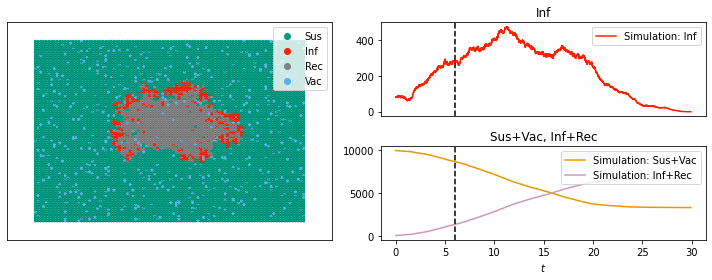

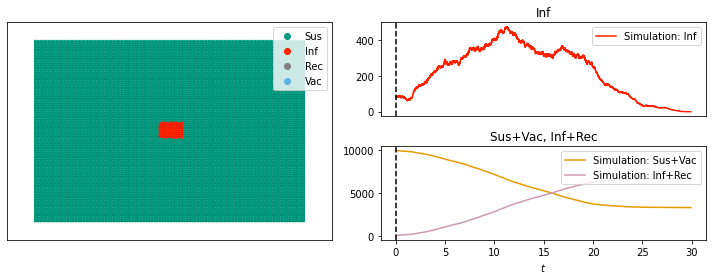

In [ ]:
"""
SIRV display and animation example
https://epidemicsonnetworks.readthedocs.io/en/latest/examples/SIRV_display.html

Modified by oudeng
"""
!pip install EoN

import networkx as nx
import EoN
import matplotlib.pyplot as plt
from collections import defaultdict

G = nx.grid_2d_graph(100,100) #each node is (u,v) where 0<=u,v<=99
#we'll initially infect those near the middle 
initial_infections = [(u,v) for (u,v) in G if 45<u<55 and 45<v<55]

H = nx.DiGraph()  #the spontaneous transitions
# https://networkx.org/documentation/stable/reference/classes/digraph.html

H.add_edge('Sus', 'Vac', rate = 0.01)
H.add_edge('Inf', 'Rec', rate = 1.0)

J = nx.DiGraph()  #the induced transitions
J.add_edge(('Inf', 'Sus'), ('Inf', 'Inf'), rate = 2.0)

IC = defaultdict(lambda:'Sus')
for node in initial_infections:
    IC[node] = 'Inf'

return_statuses = ['Sus', 'Inf', 'Rec', 'Vac']

color_dict = {'Sus': '#009a80','Inf':'#ff2000', 'Rec':'gray','Vac': '#5AB3E6'}
pos = {node:node for node in G}
tex = False
sim_kwargs = {'color_dict':color_dict, 'pos':pos, 'tex':tex}

sim = EoN.Gillespie_simple_contagion(G, H, J, IC, return_statuses, tmax=30, return_full_data=True, sim_kwargs=sim_kwargs)

times, D = sim.summary() 
#
#imes is a numpy array of times.  D is a dict, whose keys are the entries in
#return_statuses.  The values are numpy arrays giving the number in that 
#status at the corresponding time.

newD = {'Sus+Vac':D['Sus']+D['Vac'], 'Inf+Rec' : D['Inf'] + D['Rec']}
#
#newD is a new dict giving number not yet infected or the number ever infected
#Let's add this timeseries to the simulation.
#
new_timeseries = (times, newD) 
sim.add_timeseries(new_timeseries, label = 'Simulation', color_dict={'Sus+Vac':'#E69A00', 'Inf+Rec':'#CD9AB3'})

sim.display(6, node_size = 4, ts_plots=[['Inf'], ['Sus+Vac', 'Inf+Rec']])
plt.savefig('SIRV_display.png')

ani=sim.animate(ts_plots=[['Inf'], ['Sus+Vac', 'Inf+Rec']], node_size = 4)  
#ani.save('SIRV_animate.mp4', fps=5, extra_args=['-vcodec', 'libx264'])

ani.save("SIRV_ani.gif", writer="pillow", dpi=100) # dpi is necesary

# 新しいセクション

In [ ]:
from IPython.display import HTML
HTML(ani.to_jshtml())